TODO Reduce amount of intro text, i.e. establish more code + prose flow.
TODO Incorporate the stuff from fitness_prediction.ipynb, it is very incremental and easy to follow.

Disclaimer: This publication is an experiment aimed to reduce publication burden at Arcadia Science by strongly coupling our analyses with our publishable results. Essentially, this is a flagship pub that is experimenting with getting out small, digestable publications that are informal, approachable, and intertwine code and figures with prose. Internally, we often share results in the form of Jupyter notebooks, and with just a little more lift, these could be publishable externally. This creates faster iteration cycle on getting community feedback. As an added bonus, what the reader is reading is itself generated from a code repository, making reproducibility a built in aspect of this pub style. If you have feedback or things you liked or didn't like, please reach out and share your opinions.

# A Curious Result with ESM Paired Token Prediction

In this blog, I'll guide you through an exploration of the ESM2 (Evolutionary Scale Modeling) model for masked token prediction, specifically focusing on how masking multiple locations in a sequence can yield insights into their interactions. For a given sequence, we'll mask two locations both individually and jointly, and investigate the changes in their predicted probabilities using relative entropy as a measure. By doing this repeatedly for each pair of residues in the sequence, the hope is that we'll start to capture the interdependencies between sequence positions. We'll compare this to the attention map of the model as well as to a contact map of the amino acids in 3D space.

## How ESM Token Prediction Works

TODO add references found in here: https://www.notion.so/arcadiascience/Improving-mutant-fitness-prediction-with-contrastive-learning-10ec4f521e3480bbadced8e40d82a519

TODO consider referencing more math here: https://www.notion.so/arcadiascience/Improving-mutant-fitness-prediction-with-contrastive-learning-10ec4f521e3480bbadced8e40d82a519

TODO use math notation that is conventional to the 2021 paper

After masking residues with a mask token `<mask>`, you send the sequence through a forward pass of the base model plus an attached decoding head that condenses the hidden dimension into the size of the vocabulary. In the end you get a logits array of shape $N \times M$, where $N$ is the number of residues and $M$ is the number of amino acids ($20$).

By applying a [softmax](https://en.wikipedia.org/wiki/Softmax_function) to each column in the logits array, you end up $P$, an array of residue probabilities at each location (still shape $N \times M$). For any masked residue $i$, you can get a prediction for the amino acid by sampling from $P(i)$ (*i.e.* from the $i$th column of $P$).

## The experiment

If the distributions are independent, then the probability distribution for the $i$th residue should be the same regardless of whether a secondary $j$th residue was also masked. Mathematically:

$$
P(i | I = \lbrace i\rbrace) = P(i | I = \lbrace i, j \rbrace)
$$

Empirically, we can assess the degree of alikeness between these two distributions with Kullback-Leibler divergence, aka *relative entropy*.

$$
D(i, j) = \sum_{a \in A} P(i | I = \lbrace i\rbrace) \log (\frac{P(i | I = \lbrace i\rbrace)}{P(i | I = \lbrace i, j\rbrace)})
$$

To make things symmetric, we’ll do the same for the $j$th residue and define an average relative entropy over the two positions:

$$
\langle D_{ij} \rangle = \frac{D(i, j) + D(j, i)}{2}
$$

$\langle D_{ij} \rangle$ measures *how much* masking the $j$th residue affects the distribution of the $i$th residue, where higher values indicates more effect, and where $\langle D_{ij} \rangle = 0$ indicates no effect.

## Sequence material

TODO Describe ADA, etc.

In [1]:
from pathlib import Path
from biotite.sequence.io.fasta import FastaFile

sequence_path = Path("sequences/P00813.fasta")
sequence = FastaFile().read(sequence_path)["P00813"]
print(f"{sequence=}")

sequence='MAQTPAFDKPKLHVHLDGSIKPETILYYGRRRGIALPANTAEGLLNVIGMDKPLTLPDFLAKFDYYMPAIAGCREAIKRIAYEFVEMKAKEGVVYVEVRYSPHLLANSKVEPIPWNQAEGDLTPDEVVALVGQGLQEGERDFGVKARSILCCMRHQPNWSPKVVELCKKYQQQTVVAIDLAGDETIPGSSLLPGHVQAYQEAVKSGIHRTVHAGEVGSAEVVKEAVDILKTERLGHGYHTLEDQALYNRLRQENMHFEICPWSSYLTGAWKPDTEHAVIRLKNDQANYSLNTDDPLIFKSTLDTDYQMTKRDMGFTEEEFKRLNINAAKSSFLPEDEKRELLDLLYKAYGMPPSASAGQNL'


## Creating the mask libraries

TODO This title is ill-fitting, but some of the content in here is good. Reorganize.

So by iteratively masking residues and subsequently sampling from $P$, we effectively create a new protein through iterative mutation.

Sounds good! But one nuance that has interested me is whether residues should be masked and sampled one at a time, or whether multiple residues should be masked simultaneously, passed through the model, and then sampled from their respective probability distribution $P(i)$.

The multiple masking approach is interesting because the model does not produce a *joint* probability distribution $P(\forall i \in I)$, it produces a series of individual $P(i)$, where $i \in I$. A key question I had was this: are the $P(i)$  distributions independent?

---

The goal is to compare the amino acid probability distributions for single- versus double-residue masking. We'll do this exhaustively for our sequence of interest, so we establish 2 different libraries: the single masks, of which there are $N$ and the double masks, of which there are $N \choose 2$.

In [2]:
from itertools import combinations

N = len(sequence)
single_masks = list(combinations(range(N), 1))
double_masks = list(combinations(range(N), 2))

print(f"{single_masks[:5]=}")
print(f"{double_masks[:5]=}")

assert len(single_masks) == N
assert len(double_masks) == N * (N - 1) / 2

single_masks[:5]=[(0,), (1,), (2,), (3,), (4,)]
double_masks[:5]=[(0, 1), (0, 2), (0, 3), (0, 4), (0, 5)]


## Model sizes

Here are the possible models for ESM2

In [3]:
class ModelName:
    M15B: str = "facebook/esm2_t48_15B_UR50D"
    M3B: str = "facebook/esm2_t36_3B_UR50D"
    M650M: str = "facebook/esm2_t33_650M_UR50D"
    M150M: str = "facebook/esm2_t30_150M_UR50D"
    M35M: str = "facebook/esm2_t12_35M_UR50D"
    M8M: str = "facebook/esm2_t6_8M_UR50D"

Big models require GPUs and for that we've been experimenting with Modal, a serverless cloud compute that integrates seamlessly with our workflows. We write a script you can check it out here, yada yada.

# Prediction

In [4]:
from src.esm import ESMMaskedPrediction

single_logits = ESMMaskedPrediction.predict(
    sequence=sequence,
    masked_positions=single_masks,
    model_name=ModelName.M8M,
    gpu="T4",
    num_gpus=5,
    batch_size=32,
    max_length=len(sequence),
)
single_logits.shape

/opt/miniconda3/envs/esm-paired-masked-tokens/lib/python3.12/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


The jobs took 12.589655876159668 seconds to run.


(361, 361, 33)

In [ ]:
double_logits = ESMMaskedPrediction.predict(
    sequence=sequence,
    masked_positions=double_masks,
    model_name=ModelName.M15B,
    gpu="H100",
    num_gpus=1,
    batch_size=64,
    max_length=len(sequence),
)
double_logits.shape

In [2]:
MODEL = "facebook/esm2_t33_650M_UR50D"
BATCH_SIZE = 256
OUT = "M8M"
N_UPDATE = 100

In [8]:
tokenizer(
    sequence,
    return_tensors="pt",
    padding=True,
    truncation=True,
    max_length=len(sequence),
)

{'input_ids': tensor([[ 0, 20,  5, 16, 11, 14,  5, 18, 13, 15, 14, 15,  4, 21,  7, 21,  4, 13,
          6,  8, 12, 15, 14,  9, 11, 12,  4, 19, 19,  6, 10, 10, 10,  6, 12,  5,
          4, 14,  5, 17, 11,  5,  9,  6,  4,  4, 17,  7, 12,  6, 20, 13, 15, 14,
          4, 11,  4, 14, 13, 18,  4,  5, 15, 18, 13, 19, 19, 20, 14,  5, 12,  5,
          6, 23, 10,  9,  5, 12, 15, 10, 12,  5, 19,  9, 18,  7,  9, 20, 15,  5,
         15,  9,  6,  7,  7, 19,  7,  9,  7, 10, 19,  8, 14, 21,  4,  4,  5, 17,
          8, 15,  7,  9, 14, 12, 14, 22, 17, 16,  5,  9,  6, 13,  4, 11, 14, 13,
          9,  7,  7,  5,  4,  7,  6, 16,  6,  4, 16,  9,  6,  9, 10, 13, 18,  6,
          7, 15,  5, 10,  8, 12,  4, 23, 23, 20, 10, 21, 16, 14, 17, 22,  8, 14,
         15,  7,  7,  9,  4, 23, 15, 15, 19, 16, 16, 16, 11,  7,  7,  5, 12, 13,
          4,  5,  6, 13,  9, 11, 12, 14,  6,  8,  8,  4,  4, 14,  6, 21,  7, 16,
          5, 19, 16,  9,  5,  7, 15,  8,  6, 12, 21, 10, 11,  7, 21,  5,  6,  9,
          7,  

# Definitions

In [3]:
from transformers import AutoTokenizer, EsmForMaskedLM
import torch
import pandas as pd
import torch.nn.functional as F
from itertools import combinations
from scipy.special import rel_entr
import numpy as np

if torch.cuda.is_available():
    _device = torch.device("cuda")
elif torch.backends.mps.is_available():
    _device = torch.device("mps")
else:
    _device = torch.device("cpu")

print(_device)

# Initialize the model and tokenizer
tokenizer = AutoTokenizer.from_pretrained(MODEL)
model = EsmForMaskedLM.from_pretrained(MODEL).to(_device)

# List of amino acids
amino_acids = [
    "A", "C", "D", "E", "F", "G", "H", "I", "K", "L", "M", "N", "P", "Q",
    "R", "S", "T", "V", "W", "Y",
]
aa_tokens = tokenizer.convert_tokens_to_ids(amino_acids)
assert len(aa_tokens) == 20, "The length of aa_tokens should be 20."
#aa_tokens = tokenizer.encode(amino_acids)[1:-1]

# Function to compute softmax probabilities for multiple masked tokens in batch
def get_masked_probs(input_ids, mask_positions_batch):
    batch_size = len(mask_positions_batch)
    inputs = input_ids.repeat(batch_size, 1)
    
    # Apply mask tokens in batch for each pair of positions
    for batch_idx, mask_positions in enumerate(mask_positions_batch):
        for pos in mask_positions:
            inputs[batch_idx, pos] = tokenizer.mask_token_id

    with torch.no_grad():
        logits = model(input_ids=inputs.to(_device)).logits
    logits_aas = logits[:, :, aa_tokens]  # Filter logits for amino acids

    probabilities = []
    for batch_idx, mask_positions in enumerate(mask_positions_batch):
        probs_for_positions = []
        for pos in mask_positions:
            probs = F.softmax(logits_aas[batch_idx, pos], dim=-1).cpu().numpy()
            probs_for_positions.append(probs)
        probabilities.append(np.array(probs_for_positions))
    return np.array(probabilities)

# Function to compute relative entropy (KL divergence)
def compute_relative_entropy(p, q):
    return np.sum(rel_entr(p, q))

/opt/miniconda3/envs/esm-paired-masked-tokens/lib/python3.12/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


mps


/opt/miniconda3/envs/esm-paired-masked-tokens/lib/python3.12/site-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


## Calculating the distributions

In [4]:
# Sequence
sequence = "MAQTPAFDKPKLHVHLDGSIKPETILYYGRRRGIALPANTAEGLLNVIGMDKPLTLPDFLAKFDYYMPAIAGCREAIKRIAYEFVEMKAKEGVVYVEVRYSPHLLANSKVEPIPWNQAEGDLTPDEVVALVGQGLQEGERDFGVKARSILCCMRHQPNWSPKVVELCKKYQQQTVVAIDLAGDETIPGSSLLPGHVQAYQEAVKSGIHRTVHAGEVGSAEVVKEAVDILKTERLGHGYHTLEDQALYNRLRQENMHFEICPWSSYLTGAWKPDTEHAVIRLKNDQANYSLNTDDPLIFKSTLDTDYQMTKRDMGFTEEEFKRLNINAAKSSFLPEDEKRELLDLLYKAYGMPPSASAGQNL"

# Tokenize the sequence and get the input IDs
inputs = tokenizer(sequence, return_tensors="pt", add_special_tokens=False)
input_ids = inputs["input_ids"].to(_device)

pairs = list(combinations(range(len(sequence)), 2))
total_pairs = len(pairs)
progress_thresholds = [int(total_pairs * i / N_UPDATE) for i in range(1, N_UPDATE + 1)]
progress_index = 0
total_processed_pairs = 0

# Store results
results = []
single_probs_cache = {}
double_probs_cache = np.zeros((len(sequence), len(sequence), len(amino_acids), 2))

for start in range(0, total_pairs, BATCH_SIZE):
    batch_pairs = pairs[start:start + BATCH_SIZE]
    
    # Collect all pairs for joint masking
    joint_probs = get_masked_probs(input_ids, batch_pairs)

    # Handle individual positions using cache
    for idx, (i, j) in enumerate(batch_pairs):
        # Get the probabilities for position i
        if i in single_probs_cache:
            single_i_probs = single_probs_cache[i]
        else:
            single_i_probs = get_masked_probs(input_ids, [[i]])[0, 0]
            single_probs_cache[i] = single_i_probs

        # Get the probabilities for position j
        if j in single_probs_cache:
            single_j_probs = single_probs_cache[j]
        else:
            single_j_probs = get_masked_probs(input_ids, [[j]])[0, 0]
            single_probs_cache[j] = single_j_probs

        double_probs_cache[i, j, :, 0] = joint_probs[idx, 0, :]
        double_probs_cache[i, j, :, 1] = joint_probs[idx, 1, :]

        # Compute relative entropy between joint masking and the individual ones
        kl_i_joint = compute_relative_entropy(single_i_probs, joint_probs[idx, 0])
        kl_j_joint = compute_relative_entropy(single_j_probs, joint_probs[idx, 1])

        pick_i = amino_acids[single_i_probs.argmax()]
        pick_j = amino_acids[single_j_probs.argmax()]

        entropy_i = -np.sum(single_i_probs * np.log(single_i_probs))
        entropy_j = -np.sum(single_j_probs * np.log(single_j_probs))
        perplexity_i = np.exp(entropy_i)
        perplexity_j = np.exp(entropy_j)

        # Store results
        result = {
            "position_i": i,
            "position_j": j,
            "aa_i": sequence[i],
            "aa_j": sequence[j],
            "pick_i": pick_i,
            "pick_j": pick_j,
            "perplex_i": perplexity_i,
            "perplex_j": perplexity_j,
            "D": (kl_i_joint + kl_j_joint) / 2,
        }
        results.append(result)

    total_processed_pairs += len(batch_pairs)

    while (progress_index < len(progress_thresholds) and
           total_processed_pairs >= progress_thresholds[progress_index]):
        percent_complete = (progress_index + 1) * 1/N_UPDATE * 100
        print(f"Processed {total_processed_pairs}/{total_pairs} pairs ({percent_complete}%)...")
        progress_index += 1

# Convert results to a DataFrame
df = pd.DataFrame(results)

Processed 768/64980 pairs (1.0%)...
Processed 1536/64980 pairs (2.0%)...
Processed 2048/64980 pairs (3.0%)...
Processed 2816/64980 pairs (4.0%)...
Processed 3328/64980 pairs (5.0%)...
Processed 4096/64980 pairs (6.0%)...
Processed 4608/64980 pairs (7.000000000000001%)...
Processed 5376/64980 pairs (8.0%)...
Processed 5888/64980 pairs (9.0%)...
Processed 6656/64980 pairs (10.0%)...
Processed 7168/64980 pairs (11.0%)...
Processed 7936/64980 pairs (12.0%)...
Processed 8448/64980 pairs (13.0%)...
Processed 9216/64980 pairs (14.000000000000002%)...
Processed 9984/64980 pairs (15.0%)...
Processed 10496/64980 pairs (16.0%)...
Processed 11264/64980 pairs (17.0%)...
Processed 11776/64980 pairs (18.0%)...
Processed 12544/64980 pairs (19.0%)...
Processed 13056/64980 pairs (20.0%)...
Processed 13824/64980 pairs (21.0%)...
Processed 14336/64980 pairs (22.0%)...
Processed 15104/64980 pairs (23.0%)...
Processed 15616/64980 pairs (24.0%)...
Processed 16384/64980 pairs (25.0%)...
Processed 16896/64980 

In [6]:
df.to_csv(frame_output, sep="\t", index=False)
df

,position_i,position_j,aa_i,aa_j,pick_i,pick_j,perplex_i,perplex_j,D
0,0,1,M,A,M,M,5.767854,1.373206,0.012084
1,0,2,M,Q,M,A,5.767854,15.217919,0.000741
2,0,3,M,T,M,L,5.767854,17.008829,0.001824
3,0,4,M,P,M,A,5.767854,16.384886,0.000755
4,0,5,M,A,M,S,5.767854,16.880812,0.000677
...,...,...,...,...,...,...,...,...,...
64975,357,359,G,N,A,A,12.864413,13.725047,1.022287
64976,357,360,G,L,A,L,12.864413,17.154972,1.224724
64977,358,359,Q,N,S,A,13.659262,13.725047,1.297583
64978,358,360,Q,L,S,L,13.659262,17.154972,1.599186


## Saving outputs

In [7]:
sequence_length = len(sequence)
num_amino_acids = len(amino_acids)
probs_array = np.zeros((sequence_length, num_amino_acids))

for p in range(sequence_length):
    if p in single_probs_cache:
        probs_array[p, :] = single_probs_cache[p]
    else:
        # If a position is missing, you may handle it as needed
        # For now, we'll print a warning and leave zeros
        print(f"Warning: No probabilities found for position {p}")

from pathlib import Path
np.save(single_output, probs_array)
np.save(double_output, double_probs_cache)

In [8]:
import pandas as pd
import numpy as np

# Assuming 'df' is your DataFrame with columns 'i', 'j', and 'T'

# Get all unique indices
indices = sorted(set(df['position_i']).union(df['position_j']))

# Create an empty DataFrame with these indices
matrix = pd.DataFrame(index=indices, columns=indices, dtype=float)

# Populate the matrix with 'D' values
for row in df.itertuples(index=False):
    i, j, D_value = row.position_i, row.position_j, row.D
    matrix.at[i, j] = D_value

# Fill the lower triangle by mirroring the upper triangle (assuming symmetry)
matrix = matrix.combine_first(matrix.T)

# Optionally fill diagonal with zeros or another value
np.fill_diagonal(matrix.values, 0)

# Convert the matrix to a numpy array and handle NaN values
matrix_values = matrix.to_numpy()
matrix_values = np.nan_to_num(matrix_values, nan=0)

## Structure analysis

In [9]:
from biotite.structure.io import load_structure
from biotite.structure.residues import apply_residue_wise, get_residues
from biotite.structure.sasa import sasa
import biotite.structure as struc

array = load_structure("P00813.pdb")
array = array[array.atom_name == "CA"]
contact_map = np.zeros((len(array), len(array)))
for i in range(len(array)):
    contact_map[i, :] = struc.distance(array[i], array)
contact_map_binary = (contact_map < 10).astype(int)

_wilke: dict[str, float] = {
    "ALA": 129.0,
    "ARG": 274.0,
    "ASN": 195.0,
    "ASP": 193.0,
    "CYS": 167.0,
    "GLN": 225.0,
    "GLU": 223.0,
    "GLY": 104.0,
    "HIS": 224.0,
    "ILE": 197.0,
    "LEU": 201.0,
    "LYS": 236.0,
    "MET": 224.0,
    "PHE": 240.0,
    "PRO": 159.0,
    "SER": 155.0,
    "THR": 172.0,
    "TRP": 285.0,
    "TYR": 263.0,
    "VAL": 174.0,
}

atomic_sasa = sasa(array, vdw_radii="Single")
solv_acc = apply_residue_wise(array, atomic_sasa, np.sum)
_, residues = get_residues(array)

for idx, residue in enumerate(residues):
    solv_acc[idx] /= _wilke[residue]

solv_acc[solv_acc > 1.0] = 1.0

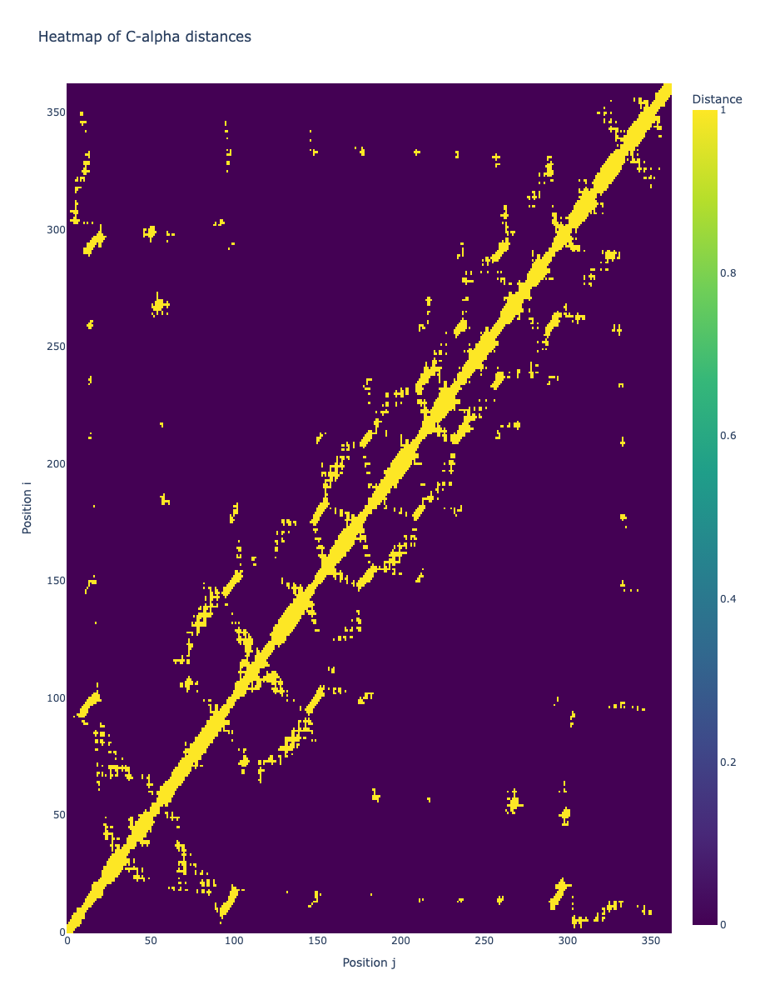

In [10]:
import plotly.graph_objects as go

fig = go.Figure(data=go.Heatmap(
        z=contact_map_binary,
        colorscale='Viridis',
        colorbar=dict(title='Distance')
    ))

fig.update_layout(
    title='Heatmap of C-alpha distances',
    xaxis_title='Position j',
    yaxis_title='Position i',
    width=1400,
    height=1200,
)

fig.show()

(array([1.26641e+05, 1.14000e+02, 3.00000e+01, 1.80000e+01, 1.00000e+01,
        6.00000e+00, 1.20000e+01, 2.00000e+01, 3.20000e+01, 3.60000e+01,
        5.80000e+01, 6.60000e+01, 8.40000e+01, 8.60000e+01, 9.20000e+01,
        1.22000e+02, 9.60000e+01, 1.12000e+02, 1.10000e+02, 1.18000e+02,
        7.60000e+01, 1.00000e+02, 9.00000e+01, 7.40000e+01, 1.16000e+02,
        6.80000e+01, 7.40000e+01, 9.40000e+01, 6.80000e+01, 6.60000e+01,
        8.80000e+01, 5.20000e+01, 7.00000e+01, 4.40000e+01, 5.60000e+01,
        7.80000e+01, 3.20000e+01, 4.00000e+01, 6.20000e+01, 1.20000e+01,
        2.20000e+01, 3.20000e+01, 3.60000e+01, 4.80000e+01, 3.60000e+01,
        2.40000e+01, 4.00000e+01, 2.80000e+01, 4.20000e+01, 4.00000e+01,
        3.60000e+01, 2.60000e+01, 3.40000e+01, 3.60000e+01, 3.60000e+01,
        4.80000e+01, 4.20000e+01, 3.00000e+01, 2.80000e+01, 1.80000e+01,
        3.20000e+01, 3.20000e+01, 3.60000e+01, 3.20000e+01, 4.20000e+01,
        3.40000e+01, 2.80000e+01, 2.00000e+01, 1.60

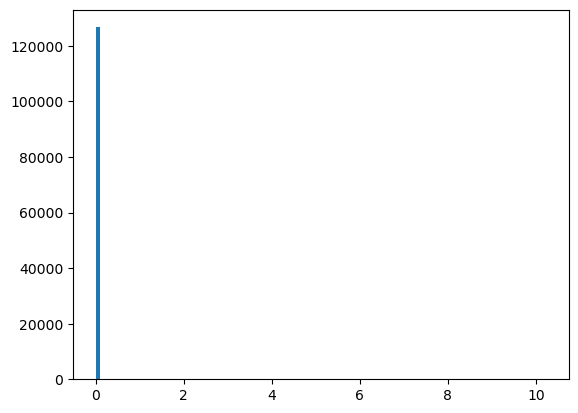

In [18]:


import matplotlib.pyplot as plt
plt.hist(matrix_values.flatten(), bins=100)

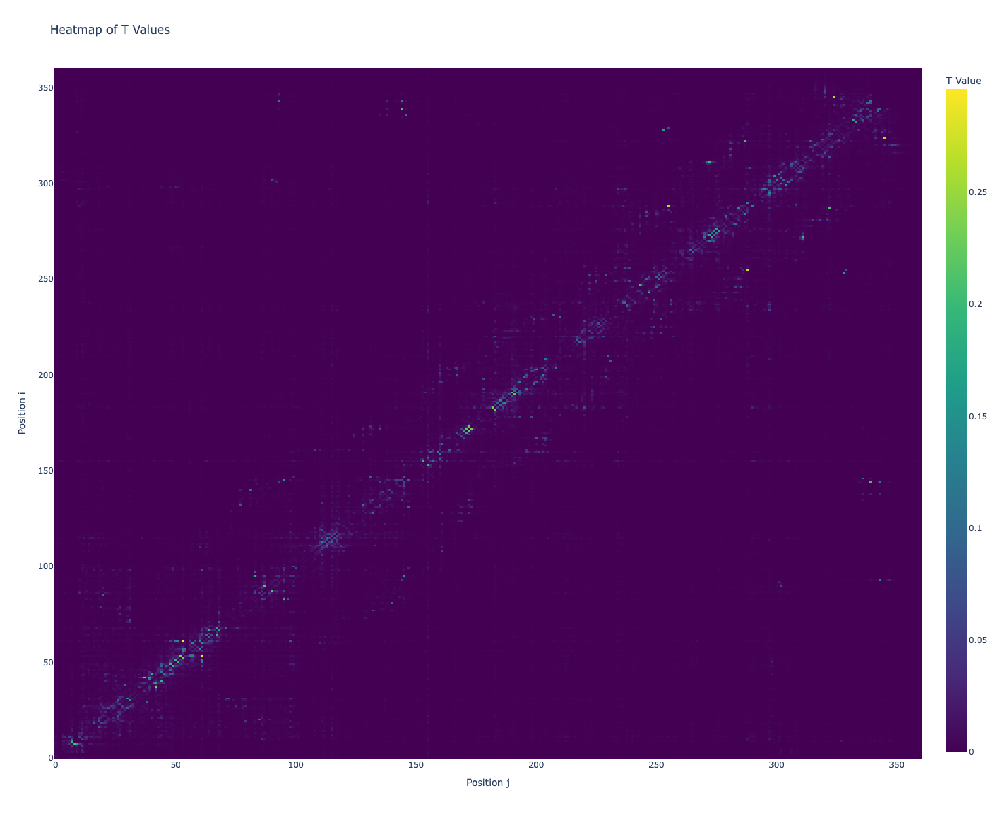

In [23]:
capped_matrix_values = matrix_values.copy()
capped_matrix_values[capped_matrix_values > 0.3] = np.median(capped_matrix_values.flatten())

fig = go.Figure(data=go.Heatmap(
        #z=np.log(matrix_values),
        z=capped_matrix_values,
        x=indices,
        y=indices,
        colorscale='Viridis',
        colorbar=dict(title='T Value')
    ))

fig.update_layout(
    title='Heatmap of T Values',
    xaxis_title='Position j',
    yaxis_title='Position i',
    width=1400,
    height=1200,
)

fig.show()

In [11]:
import numpy as np
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Example data (replace with your actual data)
size = matrix_values.shape[0]  # Use your matrix size
indices = np.arange(size)
perplex = df.groupby("position_i")["perplex_i"].mean().values

# Create subplots
fig = make_subplots(
    rows=2,
    cols=2,
    column_widths=[0.85, 0.15],
    row_heights=[0.15, 0.85],
    shared_xaxes=False,
    shared_yaxes=False,
    horizontal_spacing=0.02,
    vertical_spacing=0.02,
    specs=[
        [{"type": "bar"}, None],
        [{"type": "heatmap"}, {"type": "bar"}]
    ]
)

# Add heatmap
heatmap_trace = go.Heatmap(
    z=np.log(matrix_values),
    x=indices,
    y=indices,
    colorscale='Viridis',
    colorbar=dict(title='T Value'),
    showscale=True
)
fig.add_trace(heatmap_trace, row=2, col=1)

# Add top bar plot
top_bar_trace = go.Bar(
    x=indices,
    y=perplex,
    marker=dict(color='gray'),
    showlegend=False
)
fig.add_trace(top_bar_trace, row=1, col=1)

# Add right bar plot
right_bar_trace = go.Bar(
    x=perplex,
    y=indices,
    orientation='h',
    marker=dict(color='gray'),
    showlegend=False
)
fig.add_trace(right_bar_trace, row=2, col=2)

# Update layout
fig.update_layout(
    title='Heatmap of T Values with Solv Acc',
    width=1400,
    height=1200,
    margin=dict(t=100, b=50, l=50, r=100)
)

# Update axes
# Top bar plot axes
fig.update_xaxes(showticklabels=False, row=1, col=1)
fig.update_yaxes(row=1, col=1, ticks="outside")

# Heatmap axes
fig.update_xaxes(row=2, col=1, ticks="outside")
fig.update_yaxes(row=2, col=1, ticks="outside", autorange='reversed')

# Right bar plot axes
fig.update_xaxes(row=2, col=2, ticks="outside", side='top')
fig.update_yaxes(showticklabels=False, row=2, col=2, autorange='reversed')

# Adjust colorbar position
fig.update_layout(
    coloraxis_colorbar=dict(
        y=0.5,
        yanchor="middle",
        len=0.7,
        thickness=20,
        title='T Value'
    )
)

# Show the figure
fig.show()

/var/folders/v4/q0wyvpsj4h901lfkjcln68nw0000gn/T/ipykernel_56582/1262726847.py:28: RuntimeWarning:

divide by zero encountered in log



In [24]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.linear_model import LinearRegression

display(matrix_values.shape)
display(perplex.shape)


(361, 361)

NameError: name 'perplex' is not defined

ValueError: x and y must have same first dimension, but have shapes (130321,) and (131769,)

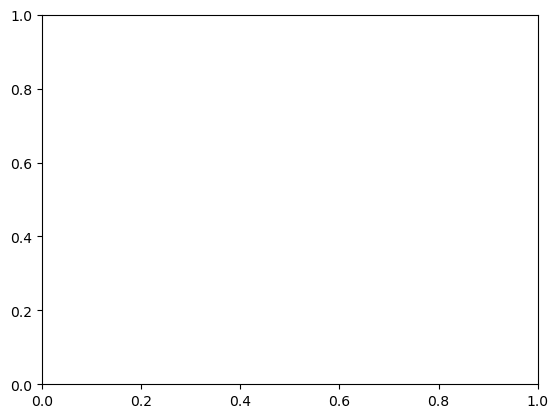

In [25]:
plt.plot(matrix_values.flatten(), contact_map.flatten())